In [1]:
import numpy as np
import os
import cv2
import copy
import argparse
import imageio
import h5py
import cv2
from collections import defaultdict
from IPython import display
from PIL import Image
import argparse
import random

def as_gif(images, path="temp.gif"):
  # Render the images as the gif (15Hz control frequency):
  images[0].save(path, save_all=True, append_images=images[1:], duration=int(1000/15), loop=0)
  gif_bytes = open(path,"rb").read()
  return gif_bytes

RESOLUTION = (256, 256)

In [2]:
class ReadH5Files():
    def __init__(self, robot_infor):
        self.camera_names = robot_infor['camera_names']
        self.camera_sensors = robot_infor['camera_sensors']
        self.arms = robot_infor['arms']
        self.robot_infor = robot_infor['controls']

    def decoder_image(self, camera_rgb_images, camera_depth_images):
        if type(camera_rgb_images[0]) is np.uint8:
            rgb = cv2.imdecode(camera_rgb_images, cv2.IMREAD_COLOR)
            if camera_depth_images is not None:
                depth_array = np.frombuffer(camera_depth_images, dtype=np.uint8)
                depth = cv2.imdecode(depth_array, cv2.IMREAD_UNCHANGED)
            else:
                depth = np.asarray([])
            return rgb, depth
        else:
            rgb_images = []
            depth_images = []
            for idx, camera_rgb_image in enumerate(camera_rgb_images):
                camera_rgb_image = np.array(camera_rgb_image)
                # print(f"camera_rgb_image: {camera_rgb_image.shape}")
                rgb = cv2.imdecode(camera_rgb_image, cv2.IMREAD_COLOR)
                if rgb is None:
                    rgb = np.frombuffer(camera_rgb_image, dtype=np.uint8)
                    if rgb.size == 2764800:
                        rgb = rgb.reshape(720, 1280, 3)
                    elif rgb.size == 921600:
                        rgb = rgb.reshape(480, 640, 3)
                if camera_depth_images is not None:
                    depth_array = np.frombuffer(camera_depth_images[idx], dtype=np.uint8)
                    depth = cv2.imdecode(depth_array, cv2.IMREAD_UNCHANGED)
                else:
                    depth = np.asarray([])
                rgb_images.append(rgb)
                depth_images.append(depth)
            rgb_images = np.asarray(rgb_images)
            depth_images = np.asarray(depth_images)
            return rgb_images, depth_images

    def execute(self, file_path, camera_frame=None, control_frame=None):
        with h5py.File(file_path, 'r') as f:
            is_sim = f.attrs['sim']
            is_compress = f.attrs['compress']
            is_compress = True
            image_dict = defaultdict(dict)
            for cam_name in self.camera_names:
                if is_compress:
                    if camera_frame is not None:
                        if len(self.camera_sensors) >= 2:
                            decode_rgb, decode_depth = self.decoder_image(
                                camera_rgb_images=f['observations'][self.camera_sensors[0]][cam_name][camera_frame],
                                    camera_depth_images=f['observations'][self.camera_sensors[1]][cam_name][camera_frame])
                        else:
                            decode_rgb, decode_depth = self.decoder_image(
                                camera_rgb_images=f['observations'][self.camera_sensors[0]][cam_name][camera_frame],
                                camera_depth_images=None)
                    else:
                        if len(self.camera_sensors) >= 2:
                            rgb_images = f['observations'][self.camera_sensors[0]][cam_name][:]
                            depth_images = f['observations'][self.camera_sensors[1]][cam_name][:]
                        else:
                            rgb_images = f['observations'][self.camera_sensors[0]][cam_name][:]
                            depth_images = None
                        print(f"rgb_images: {rgb_images.shape}")
                        decode_rgb, decode_depth = self.decoder_image(camera_rgb_images=rgb_images,camera_depth_images=depth_images)
                    
                    image_dict[self.camera_sensors[0]][cam_name] = decode_rgb
                    if len(self.camera_sensors) >= 2:
                        image_dict[self.camera_sensors[1]][cam_name] = decode_depth

                else:
                    if camera_frame:
                        image_dict[self.camera_sensors[0]][cam_name] = f[
                            'observations'][self.camera_sensors[0]][cam_name][camera_frame]
                        image_dict[self.camera_sensors[1]][cam_name] = f[
                            'observations'][self.camera_sensors[1]][cam_name][camera_frame]
                    else:
                        image_dict[self.camera_sensors[0]][cam_name] = f[
                           'observations'][self.camera_sensors[0]][cam_name][:]


            control_dict = defaultdict(dict)
            for arm_name in self.arms:
                for control in self.robot_infor:
                    if control_frame:
                        control_dict[arm_name][control] = f[arm_name][control][control_frame]
                    else:
                        control_dict[arm_name][control] = f[arm_name][control][:]
            base_dict = defaultdict(dict)
        return image_dict[self.camera_sensors[0]], control_dict, base_dict, is_sim, is_compress

def convert_dataset_image(cur_embodiments, robot_infor, resolution=RESOLUTION, dataset_dir="realworld_data", env_names=None, episode_num_pertask=2):
    read_h5files = ReadH5Files(robot_infor)

    for env_name in env_names:
        save_dir = f'quick_start_saved_images/{env_name}'
        os.makedirs(save_dir, exist_ok=True)
        
        dataset_root = os.path.join(dataset_dir, env_name, 'success_episodes/train')
        cnt = 0
        for trajectory_id in sorted(os.listdir(dataset_root))[0:episode_num_pertask]:
            for file in os.listdir(os.path.join(dataset_root, trajectory_id, 'data')):
                if file.endswith('.hdf5'):
                    file_path = os.path.join(dataset_root, trajectory_id, 'data', file)
                    break
            print('executing ', cnt, 'th trajectory, file_path:', file_path)
            cnt += 1
            assert os.path.exists(file_path), f'{file_path} does not exist'
            image_dict, control_dict, base_dict, _, is_compress = read_h5files.execute(file_path)
            action_list = []
            for keys in control_dict.keys():
                control_list = []
                for control_key in control_dict[keys].keys():
                    control = control_dict[keys][control_key]
                    control_list.append(control)
                control = np.concatenate(control_list, axis=1)
                action_list.append(control)
            action = np.concatenate(action_list, axis=1)
            state = copy.deepcopy(action)
            
            action = action[1:]
            state = state[0:-1]
            for key in image_dict.keys():
                image_dict[key] = image_dict[key][0:-1]
            
            # Process images and create GIFs for each camera
            for cam_name in image_dict.keys():
                os.makedirs(os.path.join(save_dir, trajectory_id), exist_ok=True)
                gif_path = os.path.join(save_dir, trajectory_id, f'{cam_name}.gif')
                
                # Convert images to correct color format
                images = []
                for step in range(len(image_dict[cam_name])):
                    img = np.array(image_dict[cam_name][step])
                    # print(f"cam_name: {cam_name}")
                    # print(img.shape)
                    # Convert BGR to RGB if necessary
                    if img.shape[-1] == 3:  # Check if image has 3 channels
                        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    if cur_embodiments not in ['h5_franka_3rgb', 'h5_franka_1rgb', 'h5_ur_1rgb']:
                        img = img[:, :, ::-1]
                    
                    img = cv2.resize(img, resolution, interpolation=cv2.INTER_AREA)
                    images.append(img)
                
                imageio.mimsave(gif_path, images, duration=0.1)  # 10 FPS
                print(f"Saved GIF to {gif_path}")
                # Display the GIF in the notebook
                display.display(Image(filename=gif_path))
            return 

In [20]:
env_name = "11_brushcup_2"
embodiments = "h5_agilex_3rgb"
dataset_path = "../data/dorc_kfs/qyma/RoboMIND/benchmark1_0_release"

if embodiments == "h5_ur_1rgb":
    robot_infor = { 
        "camera_names": ['camera_top'], 
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['puppet'],
        "controls": ['joint_position', 'end_effector'],
        "resolution": RESOLUTION
    }
    env_name = "close_top_drawer" if env_name is None else env_name
elif embodiments == "h5_franka_3rgb":
    robot_infor = {
        "camera_names": ['camera_top', 'camera_left', 'camera_right'],
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['puppet'],
        "controls": ['joint_position', 'end_effector'],
        "resolution": RESOLUTION
    }
    env_name = "241021_close_trash_bin_1" if env_name is None else env_name
elif embodiments == "h5_franka_1rgb":
    robot_infor = {
        "camera_names": ['camera_top'],
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['puppet'],
        "controls": ['joint_position', 'end_effector'],
        "resolution": RESOLUTION
    }
    env_name = "bread_on_table" if env_name is None else env_name
elif embodiments == "h5_tienkung_gello_1rgb":
    robot_infor = {
        "camera_names": ['camera_top'],
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['puppet','master'],
        "controls": ['joint_position'],
        "resolution": RESOLUTION
    }
    env_name = "close_the_drawer_under_the_combination_cabinet" if env_name is None else env_name
elif embodiments == "h5_tienkung_xsens_1rgb":
    robot_infor = {
        "camera_names": ['camera_top'],
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['puppet','master'],
        "controls": ['joint_position', 'end_effector'],
        "resolution": RESOLUTION
    }
    env_name = "place_button" if env_name is None else env_name
elif embodiments == "h5_agilex_3rgb":
    robot_infor = {
        "camera_names": ['camera_front', 'camera_left_wrist', 'camera_right_wrist'],
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['puppet', 'master'],
        "controls":  ['end_effector_left', 'end_effector_right', 'joint_effort_left', 'joint_effort_right', 'joint_position_left', 'joint_position_right', 'joint_velocity_left', 'joint_velocity_right'],
        "resolution": RESOLUTION
    }
    env_name = "35_putcarrot" if env_name is None else env_name
elif embodiments == "h5_simulation":
    robot_infor = {
        "camera_names":  ['camera_front_external', 'camera_handeye', 'camera_left_external', 'camera_right_external'],
        "camera_sensors": ['rgb_images', 'depth_images'],
        "arms": ['franka'],
        "controls": ['end_effector', 'joint_effort', 'joint_position', 'joint_velocity'],
        "resolution": RESOLUTION
    }
    env_name = "open_and_close_01" if env_name is None else env_name
else:
    raise ValueError(f"Invalid embodiment: {embodiments}")
dataset_dir = os.path.join(dataset_path, embodiments)
cur_embodiments = embodiments
read_h5files = ReadH5Files(robot_infor)
dataset_root = os.path.join(dataset_dir, env_name, 'success_episodes/train')
# check the longest trajectory
max_len, max_trajectory_id = 0, None
for trajectory_id in os.listdir(dataset_root):
    for file in os.listdir(os.path.join(dataset_root, trajectory_id, 'data')):
        if file.endswith('.hdf5'):
            file_path = os.path.join(dataset_root, trajectory_id, 'data', file)
            break
    image_dict, control_dict, base_dict, _, is_compress = read_h5files.execute(file_path)
    max_len = max(max_len, len(image_dict[list(image_dict.keys())[0]]))
    if max_len == len(image_dict[list(image_dict.keys())[0]]):
        max_trajectory_id = trajectory_id
print('max_len:', max_len, 'max_trajectory_id:', max_trajectory_id)

rgb_images: (545,)
rgb_images: (545,)
rgb_images: (545,)
max_len: 545 max_trajectory_id: 2024_09_28-14_41_57-172863000871525536.00


executing  2024_09_28-14_41_57-172863000871525536.00 th trajectory, file_path: ../data/dorc_kfs/qyma/RoboMIND/benchmark1_0_release/h5_agilex_3rgb/11_brushcup_2/success_episodes/train/2024_09_28-14_41_57-172863000871525536.00/data/trajectory.hdf5
rgb_images: (545,)
rgb_images: (545,)
rgb_images: (545,)
#images: 544


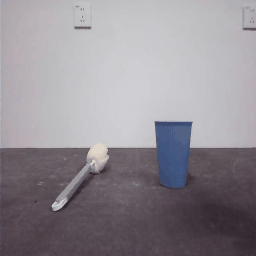

In [21]:
trajectory_id = random.choice(sorted(os.listdir(dataset_root)))

for file in os.listdir(os.path.join(dataset_root, trajectory_id, 'data')):
    if file.endswith('.hdf5'):
        file_path = os.path.join(dataset_root, trajectory_id, 'data', file)
        break
print('executing ', trajectory_id, 'th trajectory, file_path:', file_path)
assert os.path.exists(file_path), f'{file_path} does not exist'
image_dict, control_dict, base_dict, _, is_compress = read_h5files.execute(file_path)
action_list = []
for keys in control_dict.keys():
    control_list = []
    for control_key in control_dict[keys].keys():
        control = control_dict[keys][control_key]
        control_list.append(control)
    control = np.concatenate(control_list, axis=1)
    action_list.append(control)
action = np.concatenate(action_list, axis=1)
state = copy.deepcopy(action)

action = action[1:]
state = state[0:-1]
for key in image_dict.keys():
    image_dict[key] = image_dict[key][0:-1]

# Process images and create GIFs for each camera
for cam_name in image_dict.keys():

    if cam_name != list(image_dict.keys())[0]:
        continue
    
    # Convert images to correct color format
    images = []
    for step in range(len(image_dict[cam_name])):
        img = np.array(image_dict[cam_name][step])
        # print(f"cam_name: {cam_name}")
        # print(img.shape)
        # Convert BGR to RGB if necessary
        if img.shape[-1] == 3:  # Check if image has 3 channels
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        if cur_embodiments not in ['h5_franka_3rgb', 'h5_franka_1rgb', 'h5_ur_1rgb']:
            img = img[:, :, ::-1]
        
        img = cv2.resize(img, RESOLUTION, interpolation=cv2.INTER_AREA)
        images.append(Image.fromarray(img))

print(f"#images: {len(images)}")
display.Image(as_gif(images))